# Нейросети

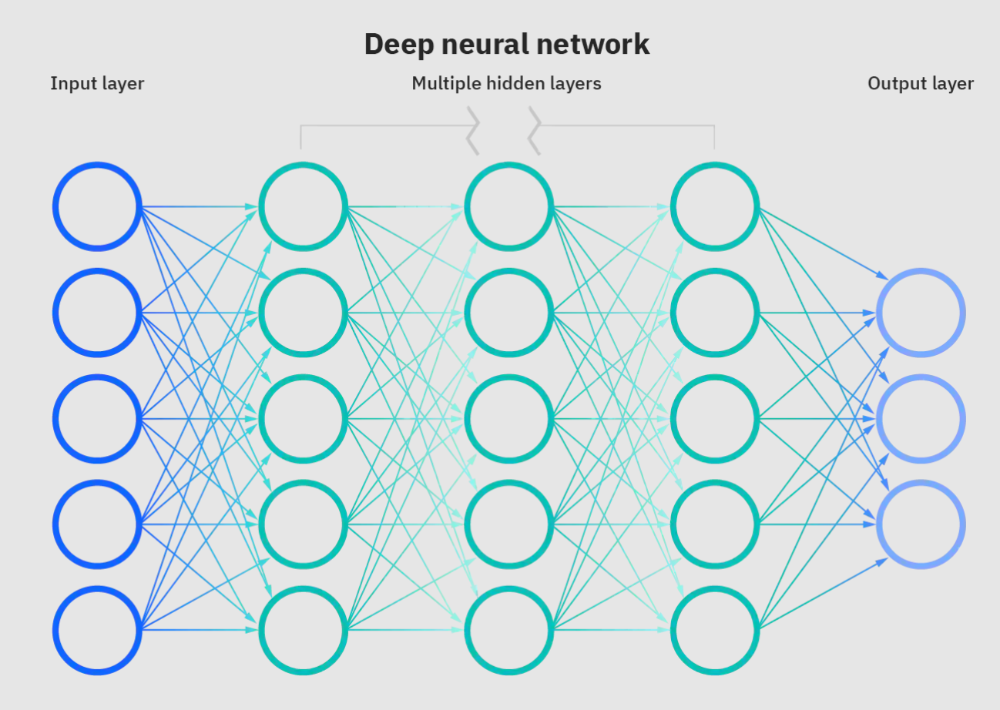

## Какие задачи решают?

### Computer vision

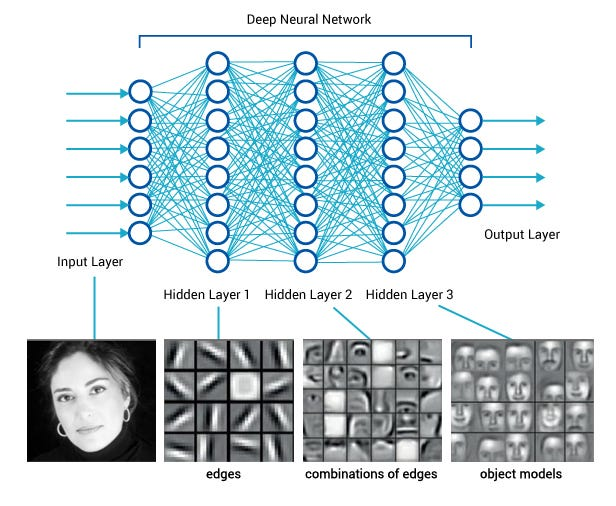

- Классификация/регрессия изображений
- Детекция обьектов на изображении
- Сегментация обьектов на изображении
- Генерация текстового описания по изображению и многое другое...

### NLP

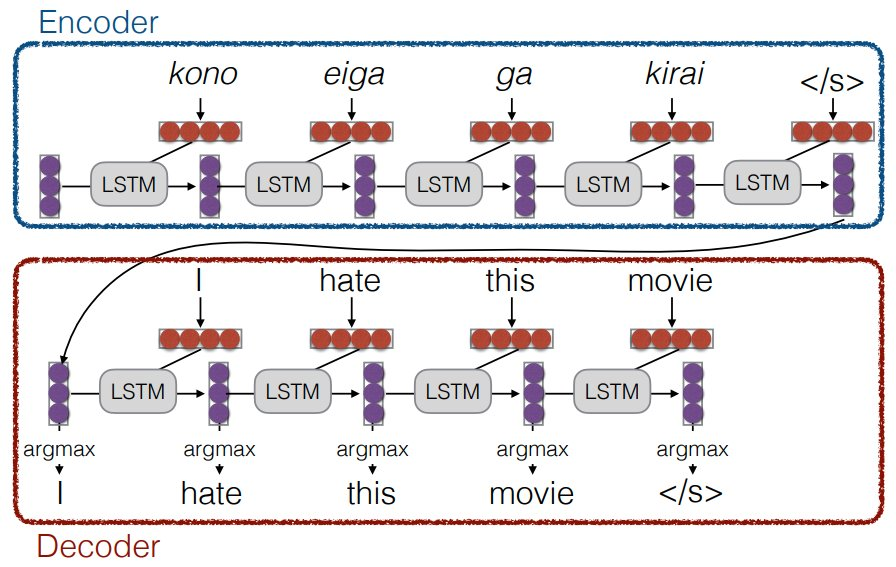

- Классификация/регрессия текста
- Выделение сущностей в тексте
- Краткое описание текста и многое другое

### Speech recognition

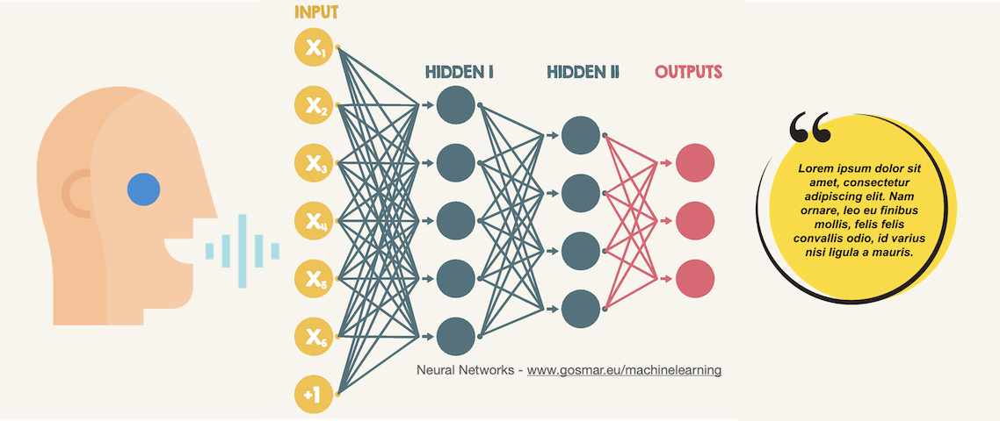

- Классификация/регрессия речи/звука
- Выделение сущностей в речи
- Распознавание речи/звуков и многое другое

### И многое другое снова)

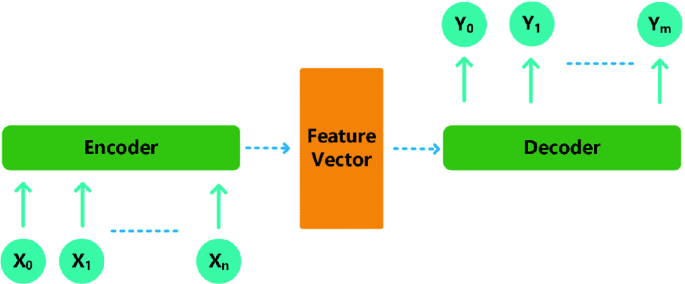



- Под энкодером следует понимать любое преобразование ваших данных в вектор признаков. Данный вектор признако идельно описывает ваши обьекты с точки зрения сети.
- Декодер берет любое скрытое представление (то есть вектор признаков) и преобразует его в любой формат данных, который необходим.

## Как работают?

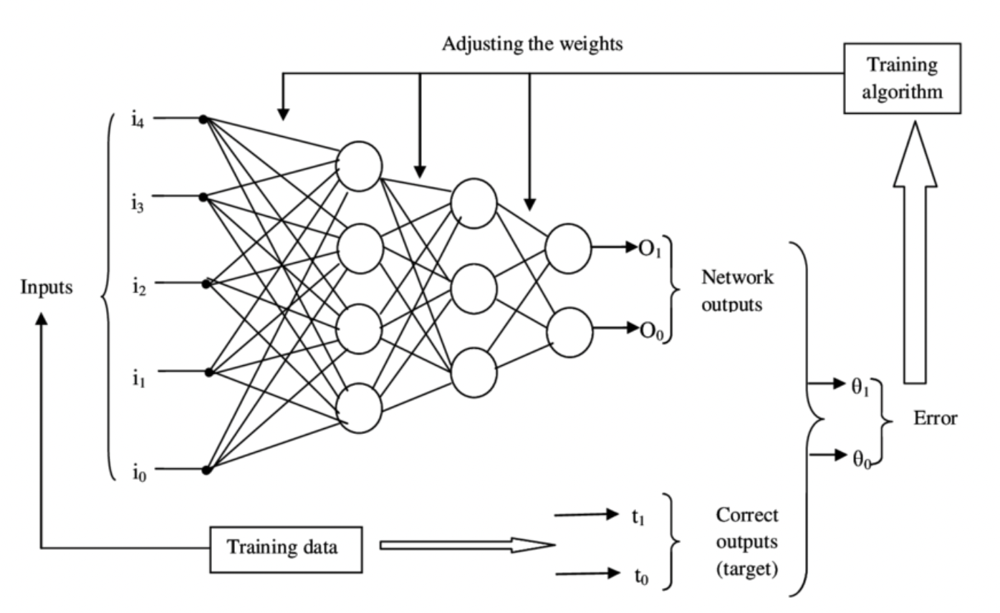

`inputs` - любой типа данных в векторном представлении 

Весь пайплайн выглядит так: https://machinelearningknowledge.ai/wp-content/uploads/2019/10/Backpropagation.gif

Еще подробнее:

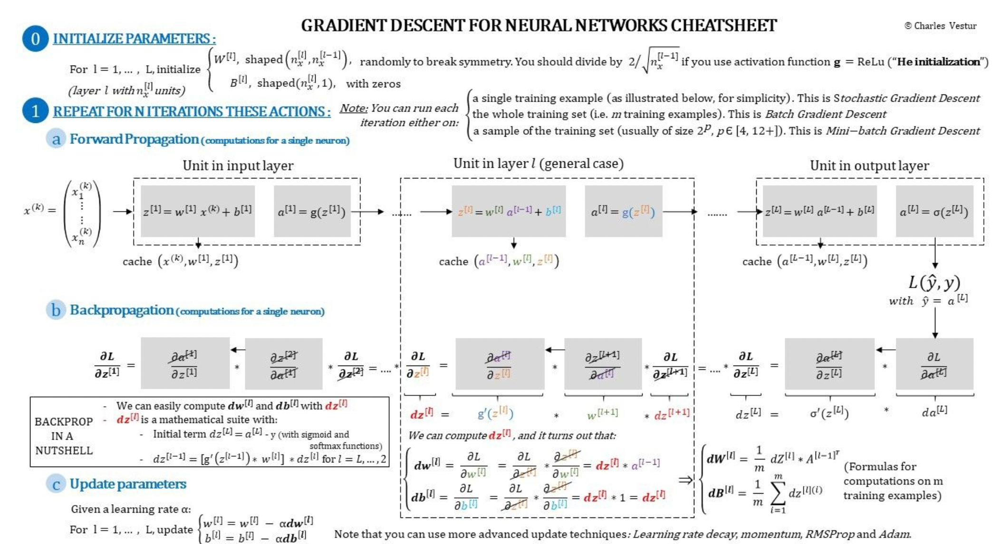

#### Разбираемся...

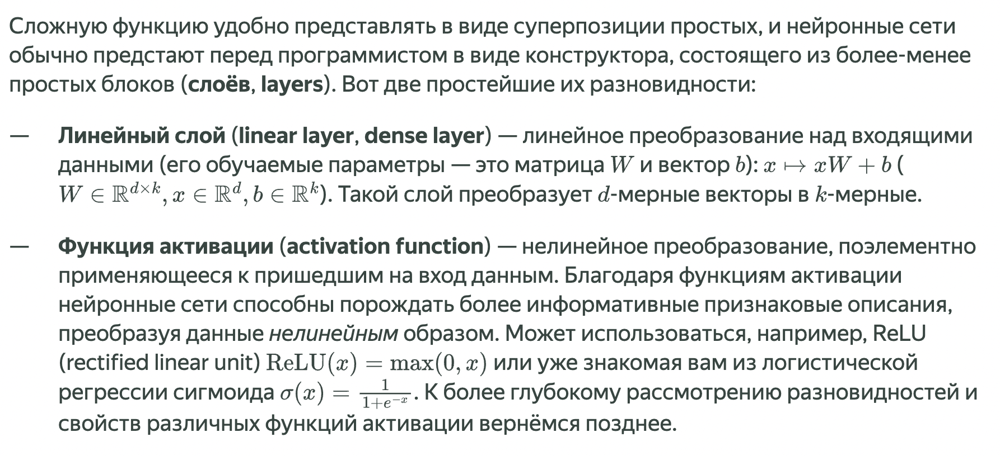

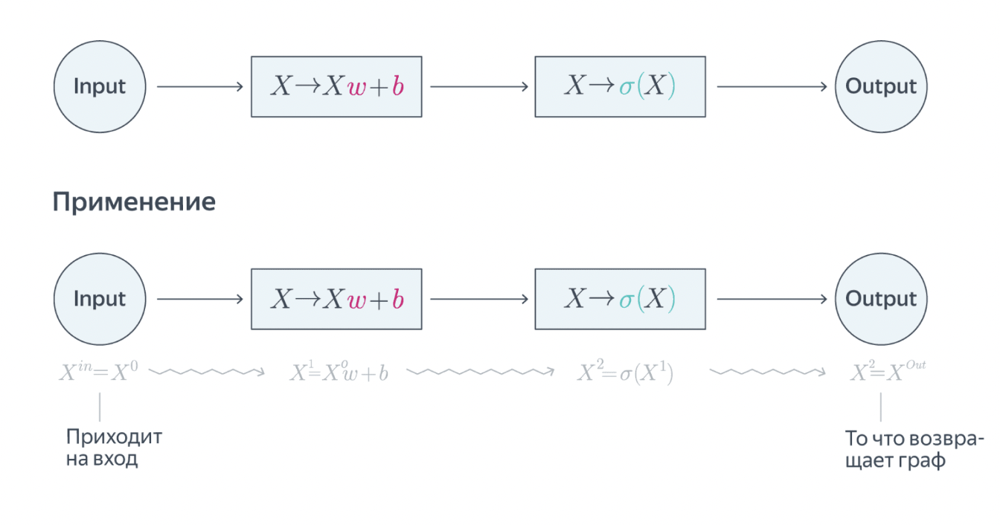

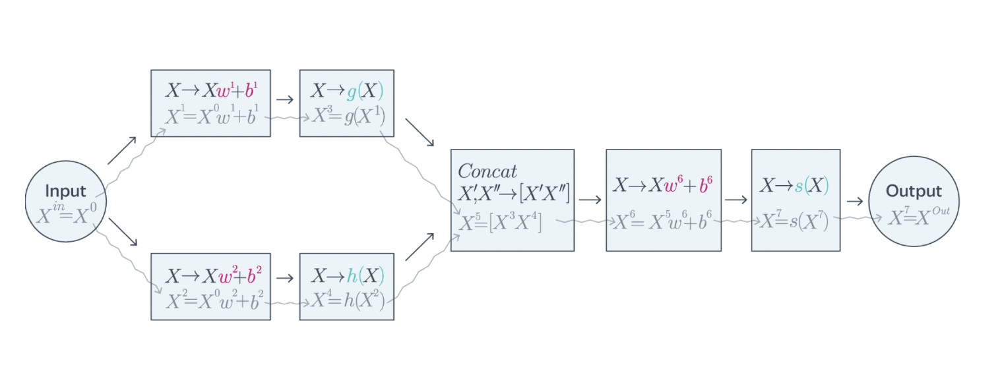

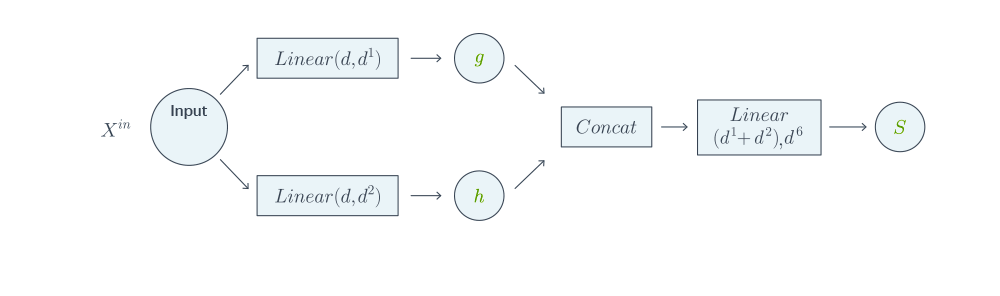

Проход вперде

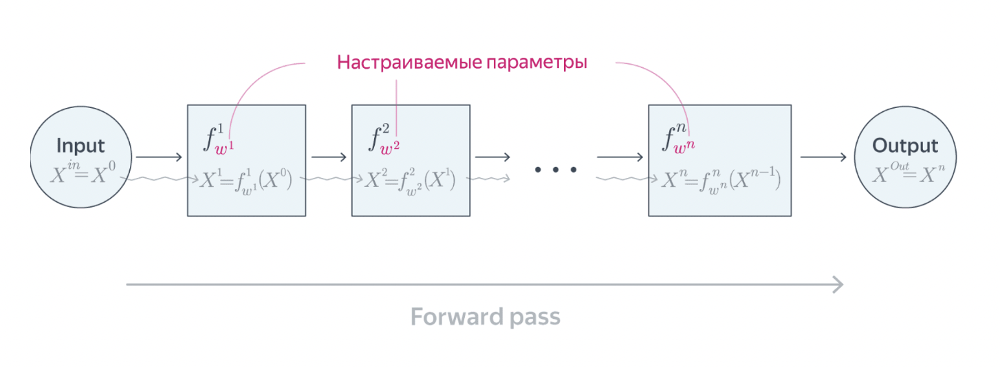

Проход взад

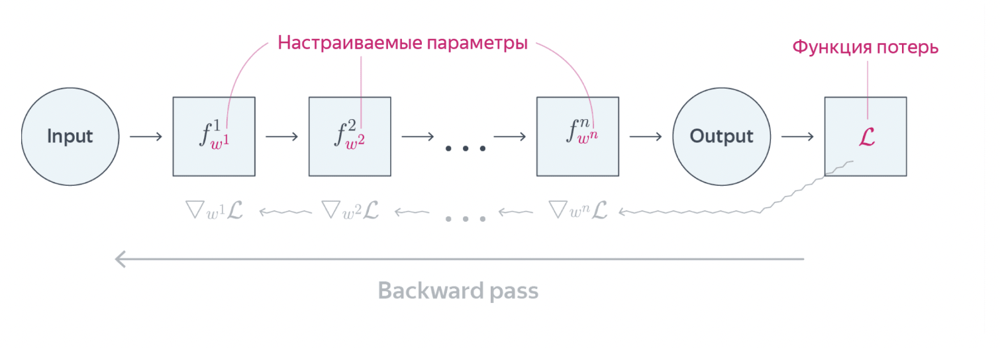

Простейшие пример

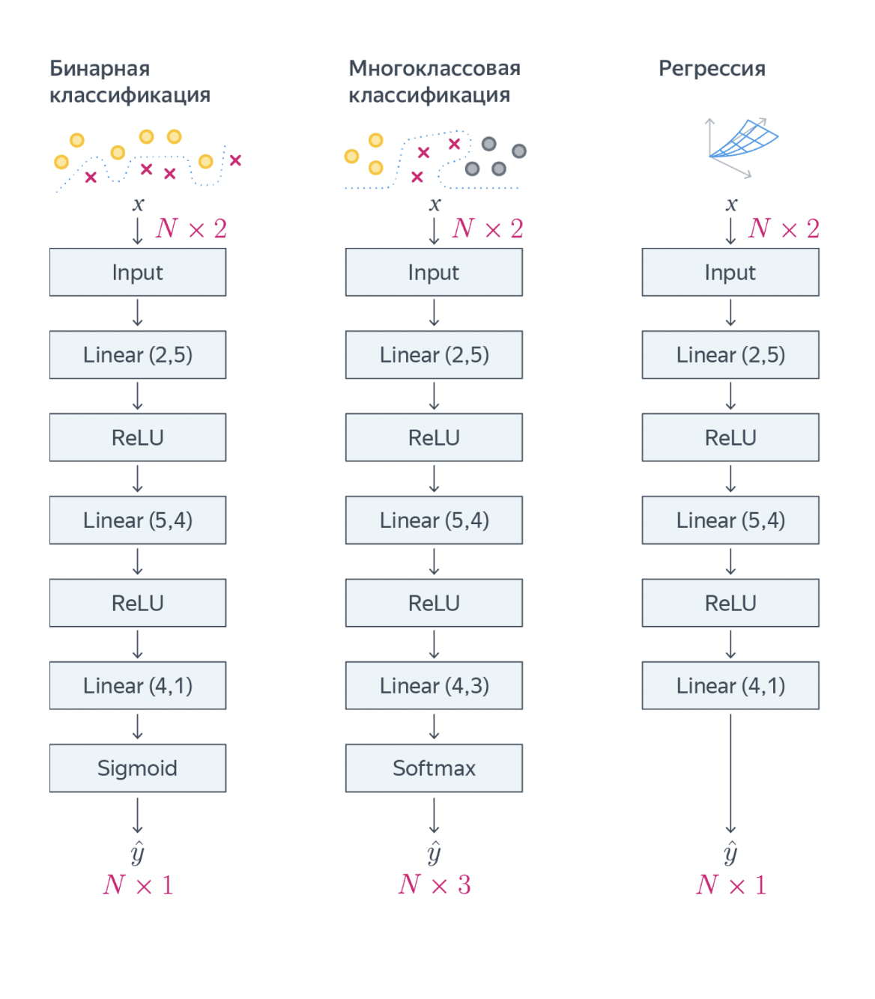

## Какие библиотеки есть для работы с нейросетями?

#### Pytorch

[Ссылка](https://pytorch.org/)

- Изначально пилили под исследователей. Поэтому это лучший фреймворк для ресерча. Есть возможность легко строить свои архитектуры и методы.
- В последнее время сравнялся по перфу и гибкости с фреймворками, которые расчитаны на быстрый прод и деплой нейросеток.
- Постоянно развивается, пользуется 99% дата сатанистов.
- Куча всяких библиотек, которые ориентированы на нужные вам домены (CV, NLP, Audio, ...)
- Всегда есть в требованиях в вакансиях

#### Tensorflow

[Ссылка](https://www.tensorflow.org/?hl=ru)

- Пилили для быстрого и гибкого деплоя, поэтому один из лучших по этим показателям.
- До сих пор поддерживается и пытается конкурировать с Pytorch.
- Есть в требованиях в вакансиях у 10% работодателей.

#### Mxnet

[Ссылка](https://mxnet.apache.org/versions/1.9.1/)

- Неплохой профит для обучения на несольких ГПУ. Вроде иногда быстрее и менее требователен, чем фреймворки выше.
- Есть небольшая поддержка, до сих пор обновляется. П.С: он закрыт
- Работодатели о нем не знают :)

## Фундументальные архитектуры

#### Полносвязные нейросети

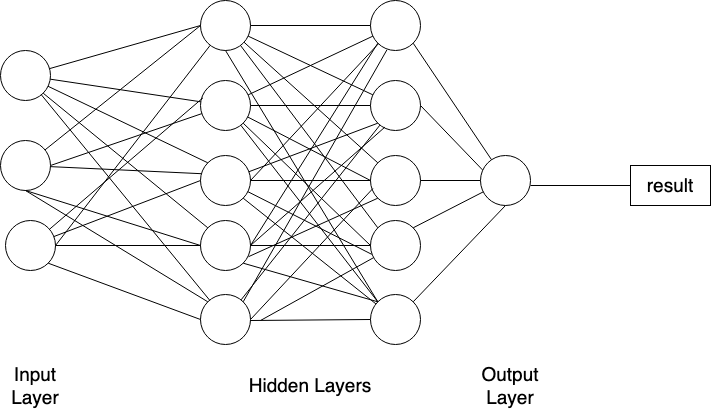

#### Сверточные нейросети

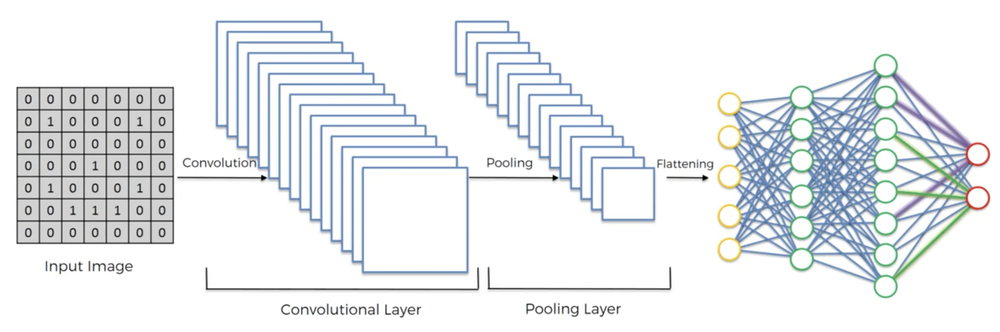

#### Рекуррентные нейросети

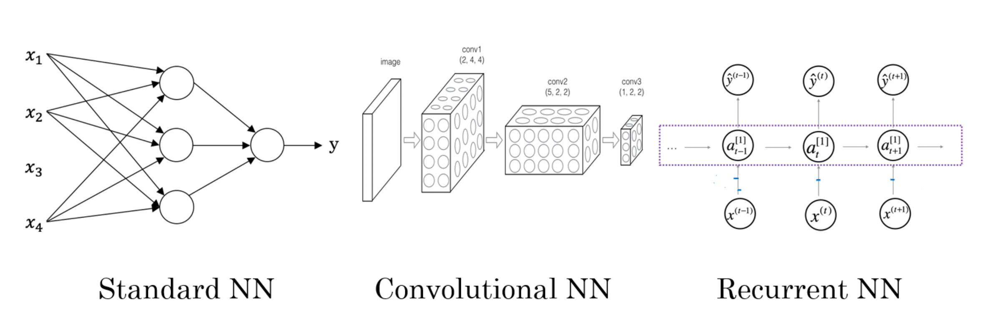

#### Трансформеры

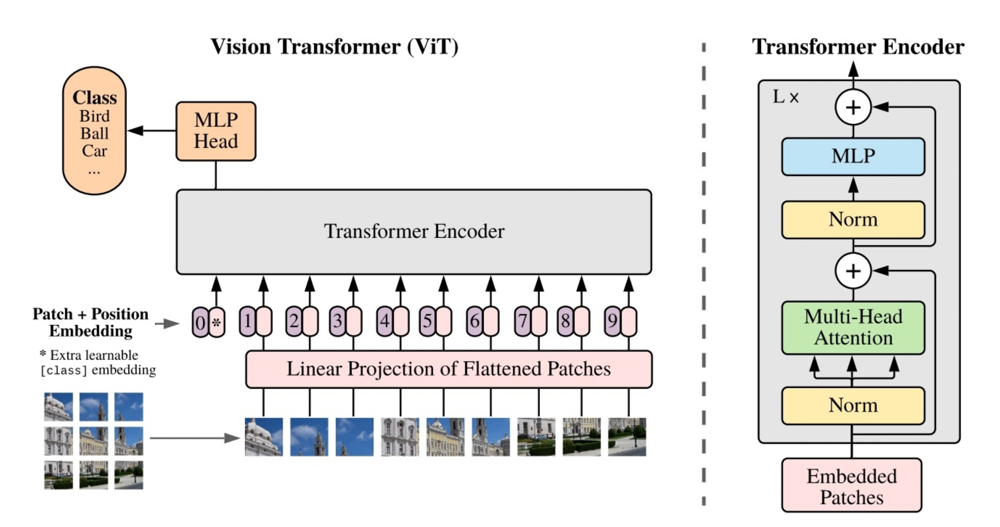

#### Гибриды

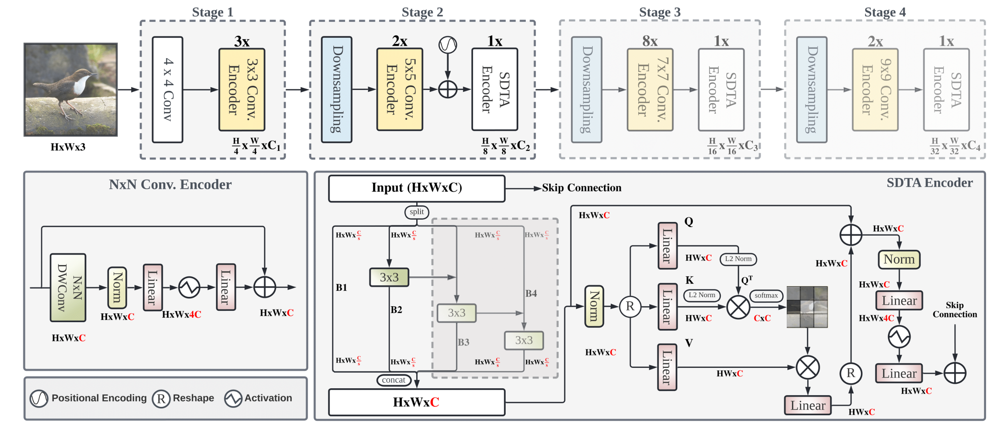

## Фундументальные блоки и функции усложнения

#### Полносвязный слой

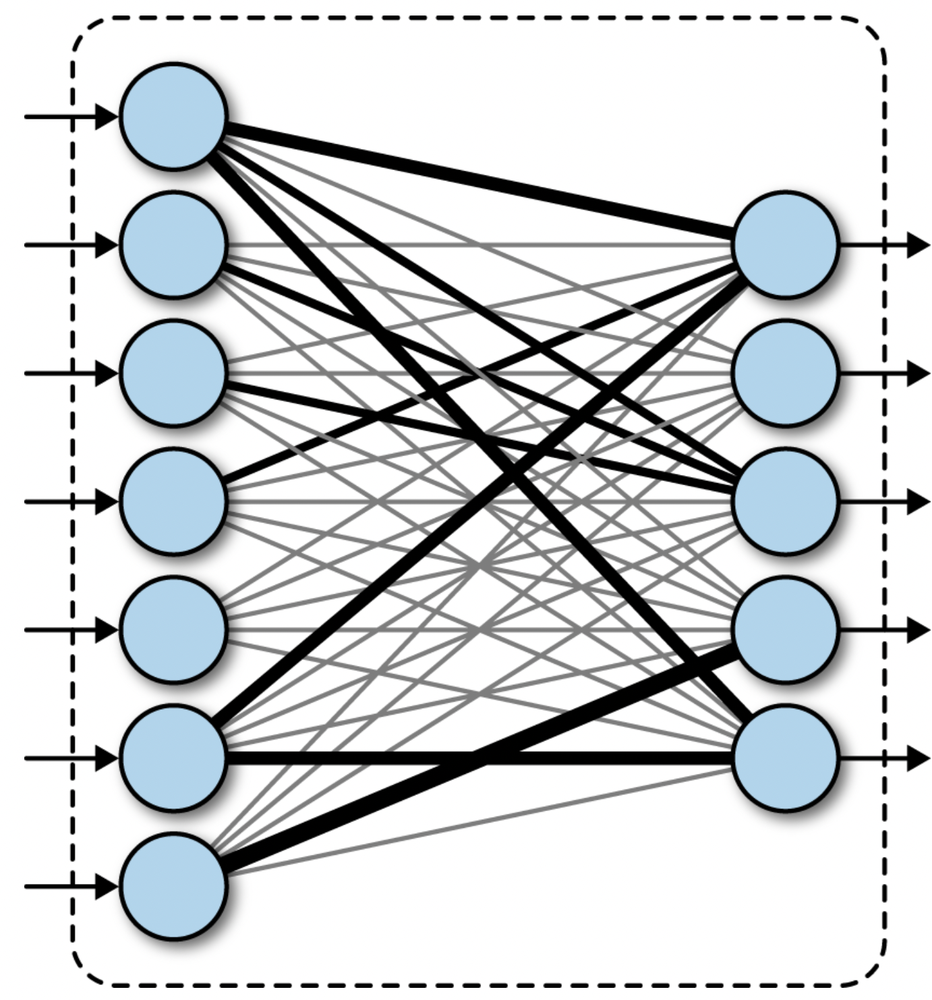

In [2]:
import torch

linear = torch.nn.Linear(in_features=2, out_features=1, bias=False)

input = torch.ones(1, 2)
output = linear(input)

print(f'linear: {linear.weight}')
print(f'input: {input}')
print(f'output: {output}')

linear: Parameter containing:
tensor([[ 0.4123, -0.2624]], requires_grad=True)
input: tensor([[1., 1.]])
output: tensor([[0.1500]], grad_fn=<MmBackward0>)


#### Сверточный слой

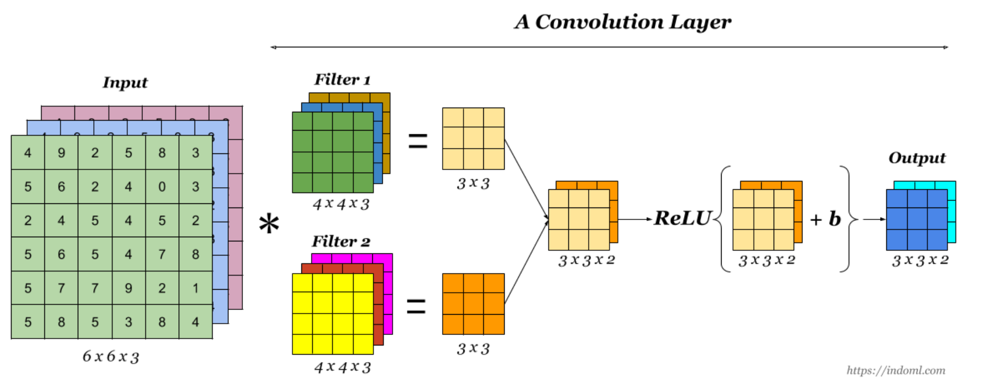

In [3]:
import torch

conv = torch.nn.Conv2d(in_channels=1, out_channels=2, kernel_size=2, stride=1, padding=0, bias=False)
input = torch.ones(1, 2, 2)
output = conv(input)

print(f'conv: {conv.weight}')
print(f'input: {input}')
print(f'output: {output}')

conv: Parameter containing:
tensor([[[[-0.3375,  0.3310],
          [-0.3548,  0.1905]]],


        [[[ 0.3891,  0.0524],
          [ 0.0620,  0.0032]]]], requires_grad=True)
input: tensor([[[1., 1.],
         [1., 1.]]])
output: tensor([[[-0.1709]],

        [[ 0.5067]]], grad_fn=<SqueezeBackward1>)


#### Pooling слои

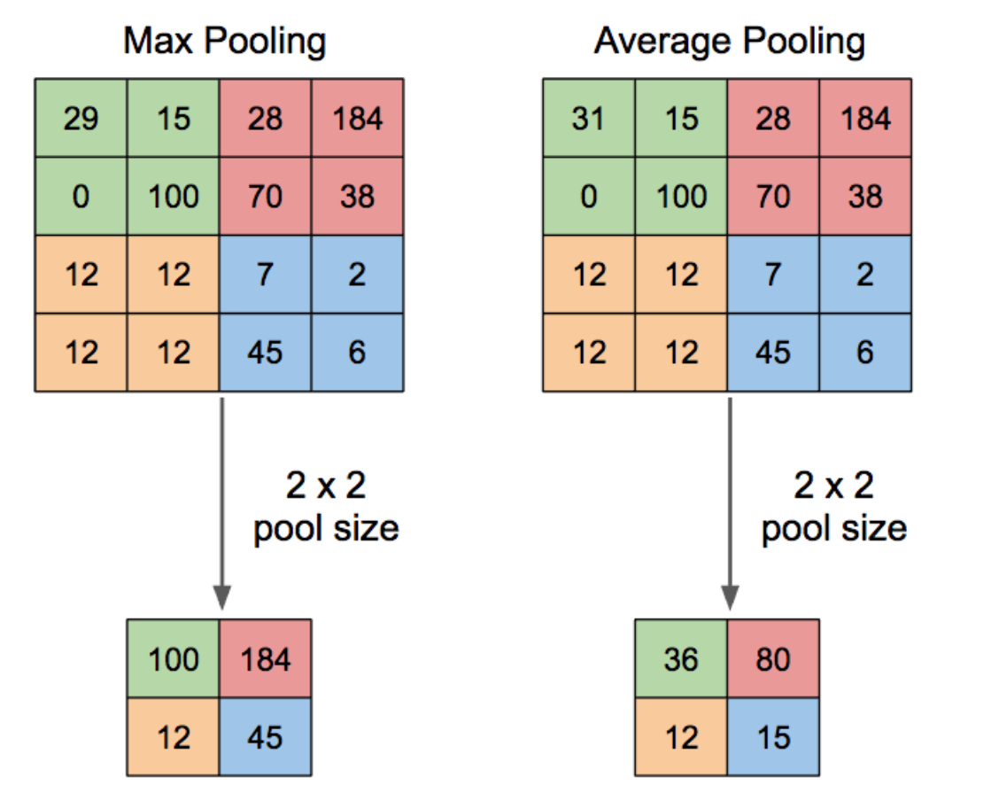

In [4]:
import torch

pool = torch.nn.MaxPool2d(kernel_size=2, stride=1, padding=1)
input = torch.rand(1, 2, 2)
output = pool(input)

print(f'input: {input}')
print(f'output: {output}')

input: tensor([[[0.6561, 0.7856],
         [0.6994, 0.6816]]])
output: tensor([[[0.6561, 0.7856, 0.7856],
         [0.6994, 0.7856, 0.7856],
         [0.6994, 0.6994, 0.6816]]])


#### Слои усложнения

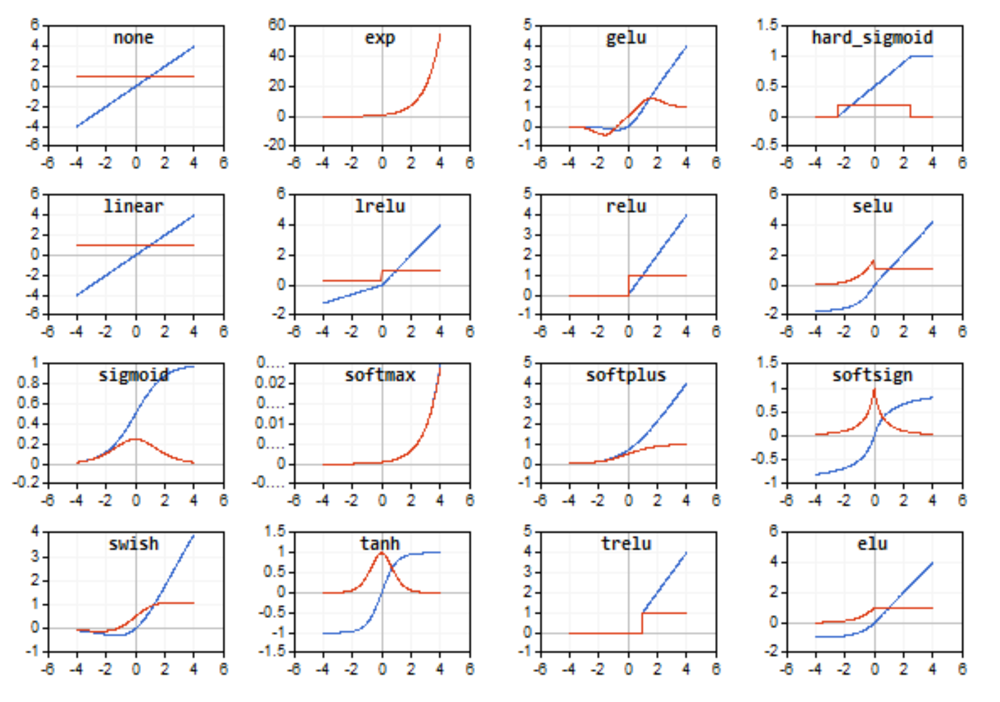

In [5]:
import torch

relu = torch.nn.ReLU()
input = torch.rand(1, 2, 2) - 0.5
output = relu(input)

print(f'input: {input}')
print(f'output: {output}')

input: tensor([[[ 0.4399, -0.1668],
         [-0.1943,  0.0133]]])
output: tensor([[[0.4399, 0.0000],
         [0.0000, 0.0133]]])


#### Слои нормализации

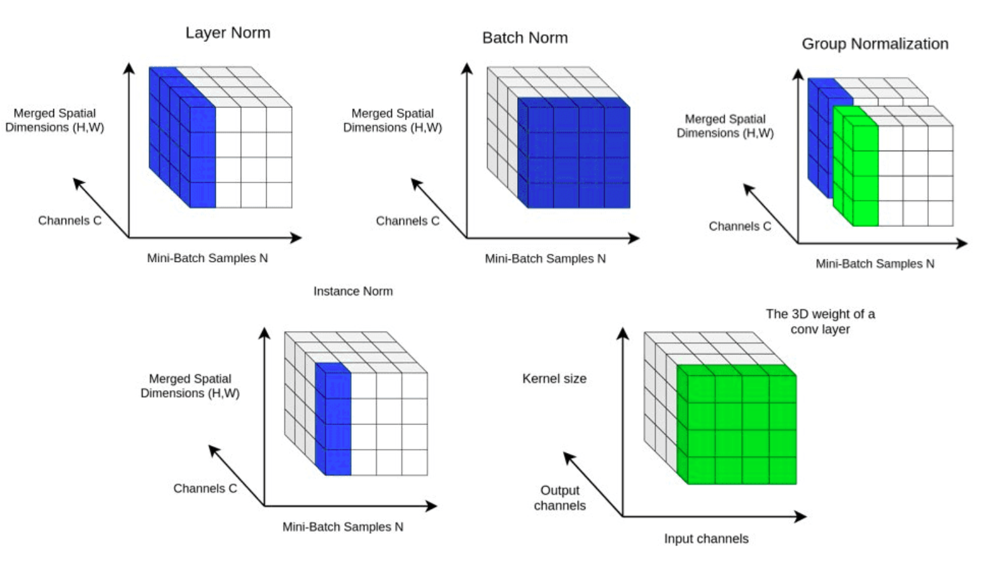

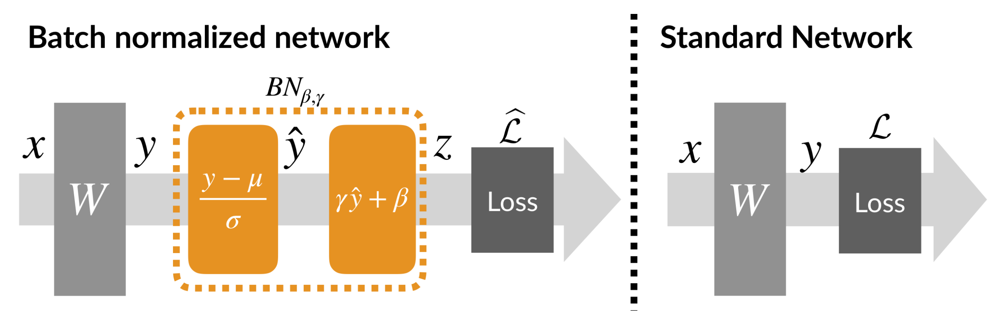

In [6]:
import torch
batch_size = 32
norm = torch.nn.BatchNorm2d(num_features=1)
input = torch.rand(batch_size, 1, 2, 2)
output = norm(input)

print(f'norm: {norm.weight}')
print(f'input: {input.mean()}, {input.std()}')
print(f'output: {output.mean()}, {output.std()}')

norm: Parameter containing:
tensor([1.], requires_grad=True)
input: 0.555512011051178, 0.25385594367980957
output: 1.0337680578231812e-07, 1.0038508176803589


#### Ансамблирование как слой (Дроп аут)

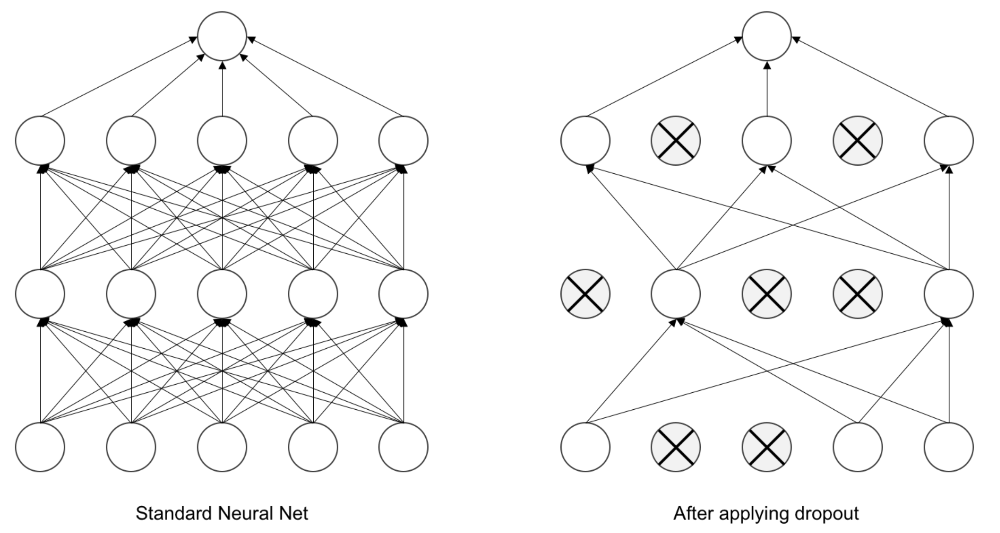

In [184]:
import torch

drop = torch.nn.Dropout(p=0.66)
input = torch.rand(1, 2, 2)
output = drop(input)

print(f'input: {input}')
print(f'output: {output}')

input: tensor([[[0.4918, 0.4111],
         [0.6901, 0.4533]]])
output: tensor([[[1.4466, 0.0000],
         [2.0296, 0.0000]]])


In [72]:
drop.eval()
output = drop(input)

print(f'input: {input}')
print(f'output: {output}')

input: tensor([[[0.6649, 0.9320],
         [0.4187, 0.4772]]])
output: tensor([[[0.6649, 0.9320],
         [0.4187, 0.4772]]])


## Pytorch

In [73]:
import torch # тут весь базовый функционал

import torch.nn # тут все, что нужно для построение нейросетей

import torch.nn.functional # тут все функции для работы с нейросетями

import torch.optim # тут все по оптимизаторам

import torch.optim.lr_scheduler # тут планировщики обучения

import torch.amp # тут функции для mix-precision обучения

import torch.cuda # тут все для взаимодействия с ГПУ

import torch.utils.data # тут все для работы с данными

#### Тензоры

In [15]:
print(torch.tensor([1, 2, 3]))
print(torch.tensor([1, 2, 3], dtype=torch.float32))
print(torch.tensor([1, 2, 3], dtype=torch.float32, device='cpu'))

tensor([1, 2, 3])
tensor([1., 2., 3.])
tensor([1., 2., 3.])


In [17]:
print(torch.arange(0, 10, 1))
print(torch.arange(0, 10, 2.5))

tensor([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
tensor([0.0000, 2.5000, 5.0000, 7.5000])


In [22]:
print(torch.zeros(1, 2))
print(torch.ones(1, 2))
print(torch.rand(1, 2))
print(torch.randn(1, 2))

tensor([[0., 0.]])
tensor([[1., 1.]])
tensor([[0.0404, 0.2613]])
tensor([[-1.1210,  0.7222]])


In [23]:
print(torch.unique(torch.tensor([1, 2, 3, 1, 2])))

tensor([1, 2, 3])


#### Пример простейшей нейросети

In [74]:
import torch

class Classificator(torch.nn.Module):
    def __init__(self, num_classes = 1):
        super().__init__()
        
        self._conv1 = torch.nn.Conv2d(in_channels=3, out_channels=32, kernel_size=5)
        self._relu1 = torch.nn.ReLU()
        self._norm1 = torch.nn.BatchNorm2d(num_features=32)

        self._pool1 = torch.nn.MaxPool2d(kernel_size=2)

        self._conv2 = torch.nn.Conv2d(in_channels=32, out_channels=16, kernel_size=5)
        self._relu2 = torch.nn.ReLU()
        self._norm2 = torch.nn.BatchNorm2d(num_features=16)

        self._drop = torch.nn.Dropout(p=0.5)
        self._fc = torch.nn.Linear(256, num_classes, bias=True)


    def forward(self, inputs):
        x = inputs
        x = self._conv1(x)
        x = self._relu1(x)
        x = self._norm1(x)
        x = self._pool1(x)
        x = self._conv2(x)
        x = self._relu2(x)
        x = self._norm2(x)
        x = torch.flatten(x, start_dim=1, end_dim=3)
        x = self._drop(x)
        x = self._fc(x)
        return x


model = Classificator(num_classes=20)

input = torch.rand(32, 3, 20, 20).clip(0, 1e-3)
with torch.no_grad():
    output = model(input)
output.shape

torch.Size([32, 20])

#### Работа с данными

In [60]:
class Dataset(torch.utils.data.Dataset):
    def __len__(self):
        return 100

    def __getitem__(self, idx):
        return torch.randn(10, dtype=torch.float32), torch.ones(1) * 100 + torch.randn(1, dtype=torch.float32)


dataset = Dataset()

dataloader = torch.utils.data.DataLoader(
    dataset=dataset,
    batch_size=4,
    shuffle=False,
    num_workers=0
)

next(iter(dataloader))

[tensor([[ 0.0723, -1.2649, -0.0036,  0.7638, -0.0319,  0.5547,  1.3903,  0.4264,
           0.1485, -2.0077],
         [-0.6116, -0.8345,  1.8971, -2.0063,  0.1643, -0.5199,  1.1967,  0.9549,
           1.8684,  0.6442],
         [ 2.7410,  2.0248,  1.9010,  1.2659, -1.1974,  0.6144,  0.0985,  0.0896,
           0.4246, -1.8667],
         [-0.5111,  0.4906, -0.2048, -0.8169, -1.1110,  0.3342,  0.6512, -0.5123,
          -0.2466, -1.5862]]),
 tensor([[101.2775],
         [ 99.6389],
         [ 98.2119],
         [ 99.7370]])]

## Цикл обучения и валидации

In [65]:
model = torch.nn.Linear(10, 1, bias=True)
loss_f = torch.nn.MSELoss()
optimizer = torch.optim.SGD(params=model.parameters(), lr=1e-2)


for epoch in range(5):
    print('=========== TRAIN ===========')
    model.train()
    for batch in dataloader:
        optimizer.zero_grad()
        data, targets = batch
        outputs = model(data)
        loss_value = loss_f(outputs, targets)
        loss_value.backward()
        optimizer.step()
        
        print(loss_value)
        
    print('=========== VAL ===========')
    model.eval()
    metric_value, n = 0.0, 0
    for batch in dataloader:
        data, targets = batch
        with torch.no_grad():
            outputs = model(data)
            metric_value += torch.nn.functional.mse_loss(outputs, targets, reduction='sum')
            n += len(data)
    print(f'MSE ERROR: {metric_value / n}')

=========== TRAIN ===========
tensor(9861.7988, grad_fn=<MseLossBackward0>)
tensor(9415.2656, grad_fn=<MseLossBackward0>)
tensor(9700.1270, grad_fn=<MseLossBackward0>)
tensor(7717.0576, grad_fn=<MseLossBackward0>)
tensor(9006.1670, grad_fn=<MseLossBackward0>)
tensor(7851.4692, grad_fn=<MseLossBackward0>)
tensor(8416.2080, grad_fn=<MseLossBackward0>)
tensor(7720.6250, grad_fn=<MseLossBackward0>)
tensor(8535.4648, grad_fn=<MseLossBackward0>)
tensor(7445.7466, grad_fn=<MseLossBackward0>)
tensor(6621.0659, grad_fn=<MseLossBackward0>)
tensor(5598.0156, grad_fn=<MseLossBackward0>)
tensor(5683.4731, grad_fn=<MseLossBackward0>)
tensor(4999.8203, grad_fn=<MseLossBackward0>)
tensor(5703.1035, grad_fn=<MseLossBackward0>)
tensor(5520.6953, grad_fn=<MseLossBackward0>)
tensor(6651.7451, grad_fn=<MseLossBackward0>)
tensor(5201.8037, grad_fn=<MseLossBackward0>)
tensor(5298.3389, grad_fn=<MseLossBackward0>)
tensor(4805.2773, grad_fn=<MseLossBackward0>)
tensor(5114.4844, grad_fn=<MseLossBackward0>)
tens

# Code time

In [1]:
# Строим простую нейросеть и учим на данных из ДЗ. Пробуем найти важные признаки

In [139]:
import pandas as pd
from sklearn.model_selection import train_test_split

class Dataset(torch.utils.data.Dataset):
    def __init__(self, dataframe, return_targets=True):
        self._x = dataframe.drop(['age', 'gender', 'race'], axis=1).values.astype('float32')
        self._y = dataframe[['age', 'gender', 'race']].values.astype('float32')
        self._return_targets = return_targets

    def __len__(self):
        return len(self._x)

    def __getitem__(self, idx):
        x = self._x[idx]

        if not self._return_targets:
            return x

        y = self._y[idx]
        return x, y

dt = pd.read_csv('assets/utk_vecs_train.csv')
train_dt, val_dt = train_test_split(dt)

train_dataset, val_dataset = Dataset(train_dt), Dataset(val_dt)

train_dataloader = torch.utils.data.DataLoader(
    dataset=train_dataset,
    batch_size=8,
    shuffle=True,
    num_workers=0
)
val_dataloader = torch.utils.data.DataLoader(
    dataset=val_dataset,
    batch_size=8,
    shuffle=False,
    num_workers=0
)

In [181]:
class RegressionModel(torch.nn.Module):
    def __init__(self, in_features):
        super().__init__()

        self._fc1 = torch.nn.Linear(in_features, 256)
        self._fc2 = torch.nn.Linear(256, 128)
        self._fc3 = torch.nn.Linear(128, 1)
        self._relu = torch.nn.ReLU()

    def forward(self, x):
        x = self._fc1(x)
        x = self._relu(x)
        x = self._fc2(x)
        x = self._relu(x)
        x = self._fc3(x)
        return x


class FaceAttributesModel(torch.nn.Module):
    def __init__(self, in_features):
        super().__init__()
        
        self._fc1 = torch.nn.Linear(in_features, 256)
        self._fc2 = torch.nn.Linear(256, 128)
        
        self._fc_age = torch.nn.Linear(128, 1)
        self._fc_gender = torch.nn.Linear(128, 2)
        self._fc_race = torch.nn.Linear(128, 5)
        
        self._relu = torch.nn.ReLU()

    def forward(self, x):
        x = self._fc1(x)
        x = self._relu(x)
        x = self._fc2(x)
        x = self._relu(x)

        age = self._fc_age(x)
        gender = self._fc_gender(x)
        race = self._fc_race(x)
        
        return age, gender, race


In [182]:
model = FaceAttributesModel(in_features=512)
loss_f_age = torch.nn.MSELoss()
loss_f_gender = torch.nn.CrossEntropyLoss()
loss_f_race = torch.nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(params=model.parameters(), lr=0.01)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer=optimizer, step_size=10, gamma=0.1)

num_epochs = 25

for epoch in range(num_epochs):
    print('=========== TRAIN ===========')
    model.train()
    lr_scheduler.step()
    sum_loss_value = 0.0
    for batch in train_dataloader:
        optimizer.zero_grad()
        data, targets = batch
        age, gender, race = model(data)

        loss_value_age = loss_f_age(age, targets[:, [0]])

        loss_value_gender = loss_f_gender(gender, targets[:, 1].long())

        loss_value_race = loss_f_race(race, targets[:, 2].long())
        
        loss_value = loss_value_age * 1.0 + loss_value_gender * 100.0 + loss_value_race * 40.0
        loss_value.backward()
        optimizer.step()
        
        sum_loss_value += loss_value.item()
    print(f'loss: {sum_loss_value / len(dataloader)}')
        
    print('=========== VAL ===========')
    model.eval()
    metric_value_age, metric_value_gender, mestric_value_race, n = 0.0, 0.0, 0.0, 0
    for batch in val_dataloader:
        data, targets = batch
        with torch.no_grad():
            age, gender, race  = model(data)
            metric_value_age += torch.nn.functional.l1_loss(age, targets[:, [0]], reduction='sum')
            metric_value_gender += (gender.argmax(1) == targets[:, 1]).sum()
            metric_value_race += (race.argmax(1) == targets[:, 2]).sum()
            n += len(data)
    print(f'AGE MAE ERROR: {metric_value_age / n}')
    print(f'GENDER ACCURACY ERROR: {metric_value_gender / n}')
    print(f'RACE ACCURACY ERROR: {metric_value_race / n}')

=========== TRAIN ===========
loss: 16471.61504386902
=========== VAL ===========
AGE MAE ERROR: 7.888782024383545
GENDER ACCURACY ERROR: 0.855400025844574
RACE ACCURACY ERROR: 0.7310000061988831
=========== TRAIN ===========
loss: 13108.796439361573
=========== VAL ===========
AGE MAE ERROR: 7.301816463470459
GENDER ACCURACY ERROR: 0.8925999999046326
RACE ACCURACY ERROR: 0.7044000029563904
=========== TRAIN ===========
loss: 12710.382271881104
=========== VAL ===========
AGE MAE ERROR: 7.015060901641846
GENDER ACCURACY ERROR: 0.9002000093460083
RACE ACCURACY ERROR: 0.7239999771118164
=========== TRAIN ===========
loss: 12052.769474563598
=========== VAL ===========
AGE MAE ERROR: 6.935651779174805
GENDER ACCURACY ERROR: 0.8726000189781189
RACE ACCURACY ERROR: 0.7070000171661377
=========== TRAIN ===========
loss: 11807.834543533325
=========== VAL ===========
AGE MAE ERROR: 7.113850116729736
GENDER ACCURACY ERROR: 0.875
RACE ACCURACY ERROR: 0.7224000096321106
=========== TRAIN =======

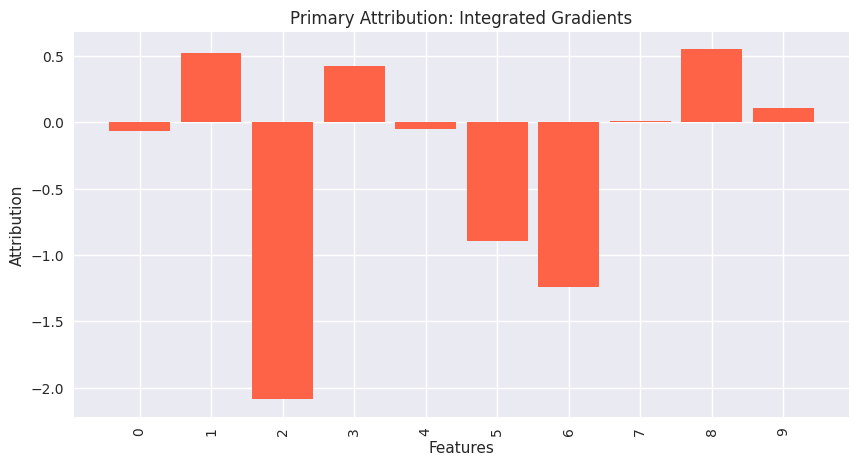

In [70]:
from captum import attr
import matplotlib.pyplot as plt
import matplotlib

interpreter = attr.IntegratedGradients(model)
attributions = interpreter.attribute(train_dataset[0][0].unsqueeze(0))



with matplotlib.style.context("seaborn"):
    plt.figure(figsize=(10,5))
    plt.bar(range(10), attributions.flatten(), width=0.85, color="tomato");
    plt.xticks(range(10), [str(i) for i in range(10)], rotation=90)
    plt.xlabel("Features");
    plt.ylabel("Attribution");
    plt.title("Primary Attribution: Integrated Gradients");